## Importações
Instalar caso não tenha na maquina, o bokeh e astropy

In [ ]:
from IPython.display import clear_output
#!pip install bokeh
#!pip install astropy
clear_output()
# necessário apenas para notebooks
%matplotlib inline 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from astropy.table import Table
from astropy.io import ascii, fits
from astropy.timeseries import LombScargle
from bokeh import plotting
from bokeh.models import Span
# necessário apenas para notebooks
plotting.output_notebook()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Definidas as funções de plotagem, listagem do dataset e busca do mesmo

In [ ]:
def listagem_dir(dir):
    import os
    pasta = dir
    data=[]
    for diretorio, subpastas, arquivos in os.walk(pasta):
        for arquivo in arquivos:
            data.append(os.path.join(diretorio,arquivo))
    data.sort()
    return data


def datasets(dir,size):
    i = 0
    x = []
    for i in range(size):
            t = Table.read(listagem_dir(dir)[i], format='ascii',names=['HJD','mag','err']).to_pandas()
            x.append(t)
    return x

def busca():
    star = 'OGLE'
    print(
    """info:
        target = NULL retorna todos os target
        target = LMC/SMC retorna os grupos
        target = numeração retorna a estrela específica
        
    Parameter Target:
      Choose OGLE observations region:
        LMC - Large Magellanic Cloud
        SMC - Small Magellanic Cloud
        BLG - Galactic bulge
        GD  - Galactic disk
        
    Parameter ID:
        OGLE-SMC-CEP-4987,
        OGLE-LMC-CEP-4709,
        OGLE-BLG-CEP-021,
        OGLE-GD-CEP-0555""")

    star = input("\n\nidentifique o target: ")
    for i in range(len(query)):
        if star in query.loc[i][0]:
            print(f'index:\ttarget:\n{i}\t{query.loc[i][0]}')
        if star == None:
            print(f'index:\ttarget:\n{i}\t{query.loc[i][0]}')

def ploting(star, index):
    # Start figure and axis.
    fig, ax = plt.subplots()

    # Plot the timeseries in black circles.
    ax.plot(star[index]["HJD"], star[index]["mag"], 'ko')

    # Let's label the axes and define a title for the figure.
    fig.suptitle(f"{query.loc[index][0]} - I-Band")
    ax.set_ylabel("Magnitude")
    ax.set_xlabel("HJD")
    plt.show()

def degradedPlot(star,index):
    # Start figure and axis.
    fig, ax = plt.subplots()

    # Plot the timeseries in black circles.
    ax.plot(star["HJD"], star["mag"], 'ko')

    # Let's label the axes and define a title for the figure.
    fig.suptitle(f"{query.loc[index][0]} - I-Band")
    ax.set_ylabel("Magnitude")
    ax.set_xlabel("HJD")
    plt.show()
  
def Detrended_Lightcurve(star,index):

  bfig = plotting.figure(plot_width=850, plot_height=300, title=f'Detrended Lightcurve ({query.loc[index][0]})')

  bfig.circle(star[index]['HJD'], star[index]['mag'], fill_color="black", size=4, line_color=None)
  bfig.line(star[index]['HJD'], star[index]['mag'], line_color='black')

  bfig.xaxis.axis_label = "Time (HJD)"
  bfig.yaxis.axis_label = "Magnitude"
  bfig.y_range.flipped = True

  plotting.show(bfig)

def periodograma(index, frequency, power):
    bfig = plotting.figure(plot_width=850, plot_height=300, x_range=(0,25),
                        title=f"Periodogram ({query.loc[index][0]}Light Curve - I-Band)")
    bfig.line(frequency, power, line_color='black')
    bfig.xaxis.axis_label = "Frequency (1/day)"
    bfig.yaxis.axis_label = "Power"

    plotting.show(bfig)

def phased_light_curve(star,index):
    bfig = plotting.figure(plot_width=850, plot_height=300, title=f'Phased light curve ({query.loc[index][0]} Light Curve - I-Band)')

    # plotagem da fase
    min_brightness = frequency[np.argmin(power)]
    t=(star[index]["HJD"]-min_brightness)/(period)
    bfig.circle(t%1,star[index]["mag"], fill_color="black",size=4,line_color=None)


    # labels axis
    bfig.xaxis.axis_label = "fase (dias)"
    bfig.yaxis.axis_label = "Flux"
    bfig.xaxis.bounds = (0,1)
    bfig.y_range.flipped = True
    plotting.show(bfig)


def phased_light_curve_ogle(star,index,interval):
    bfig = plotting.figure(plot_width=850, plot_height=300, title=f'Phased light curve ({query.loc[index][0]} Light Curve - I-Band)')

    # plotagem da fase
    min_brightness = frequency[np.argmin(power)]
    t=(star[index]["HJD"]-min_brightness)/(period)
    bfig.circle(t%interval,star[index]["mag"], fill_color="black",size=4,line_color=None)

    # labels axis
    bfig.xaxis.axis_label = "fase (dias)"
    bfig.yaxis.axis_label = "Flux"
    bfig.y_range.flipped = True
    plotting.show(bfig)

## Coleta e seleção dos dados

### Coletando os dados
Função:

(method) datasets: (dir: diretório, size: tamanho desejado, classe:any) - lista

Parâmetros

- dir : diretório
  - Caminho do dataset

- size : int
  - Tamanho que deseja coletar do dataset

In [ ]:
cepheids = datasets('/content/drive/MyDrive/datasets/cepheids/I',20)

In [ ]:
eclipsantes = datasets('/content/drive/MyDrive/datasets/eclipsing/I', 20)

### Coleta da consulta com os dados do OGLE

In [ ]:
ECL_query = pd.read_csv('/content/drive/MyDrive/datasets/eclipsing/query_1670424531.25426l.txt',skiprows = 6, nrows= 20 ,delimiter = "\t")
CEP_query = pd.read_csv('/content/drive/MyDrive/datasets/cepheids/query_1670424333.44671w.txt',skiprows = 6, nrows= 20 ,delimiter = "\t")

In [ ]:
query = [ECL_query, CEP_query]
len(query[0]), len(query[1])

(20, 20)

### Listando os dados coletados

(function) busca: () -> None

- retorna a listagem do diretório

Tipo de estrela

In [ ]:
typeStar = input('Eclipsing(E)/Cepehids(C): ')
if typeStar.lower() == 'e':
  query = ECL_query
  star = eclipsantes
else:
  query = CEP_query
  star = cepheids

Eclipsing(E)/Cepehids(C): c


In [ ]:
busca()

info:
        target = NULL retorna todos os target
        target = LMC/SMC retorna os grupos
        target = numeração retorna a estrela específica
        
    Parameter Target:
      Choose OGLE observations region:
        LMC - Large Magellanic Cloud
        SMC - Small Magellanic Cloud
        BLG - Galactic bulge
        GD  - Galactic disk
        
    Parameter ID:
        OGLE-SMC-CEP-4987,
        OGLE-LMC-CEP-4709,
        OGLE-BLG-CEP-021,
        OGLE-GD-CEP-0555


identifique o target: 
index:	target:
0	OGLE-BLG-CEP-001
index:	target:
1	OGLE-BLG-CEP-002
index:	target:
2	OGLE-BLG-CEP-003
index:	target:
3	OGLE-BLG-CEP-004
index:	target:
4	OGLE-BLG-CEP-007
index:	target:
5	OGLE-BLG-CEP-009
index:	target:
6	OGLE-BLG-CEP-015
index:	target:
7	OGLE-BLG-CEP-016
index:	target:
8	OGLE-BLG-CEP-019
index:	target:
9	OGLE-BLG-CEP-020
index:	target:
10	OGLE-BLG-CEP-021
index:	target:
11	OGLE-BLG-CEP-024
index:	target:
12	OGLE-BLG-CEP-027
index:	target:
13	OGLE-BLG-CEP-032
index:	targ

### Seleção do target, com base na listagem a cima

In [ ]:
index = int(input("Escolha o index do target: "))
print(f'target selecionado: {query.loc[index][0]}')

Escolha o index do target: 14
target selecionado: OGLE-BLG-CEP-033


## Plotagem


### Plot da relaçõa time o magnitude

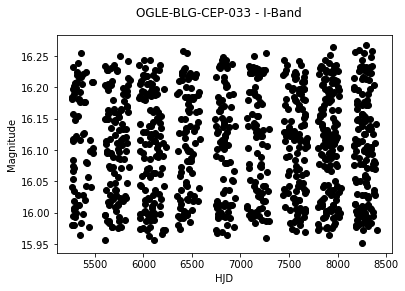

In [ ]:
ploting(star,index)

### Plot sem definir uma tendência(sem um período definido)

In [ ]:
Detrended_Lightcurve(star,index)

### Plot do periodograma

In [ ]:
lomb = LombScargle(star[index]["HJD"], star[index]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

### Encontrando um período (dias e horas)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

DADOS GERADOS
------------------------------
      OGLE-BLG-CEP-033
período dominante: 0.3935076 dias
período dominante: 9.44 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-BLG-CEP-033
período dominante: 0.3935104 dias
período dominante: 9.44 horas

 ERRO
------------------------------
erro do período: 2.7739e-06 dias


In [ ]:
print(f'''DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}
amplitude: {np.max(star[index]["mag"])} mag
\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
amplitude: {query.loc[index][4]} mag
\n ERRO\n{'-'*30}
erro de amplitude: {abs(query.loc[index][4]-(np.max(star[index]["mag"]))):.5} mag''')

DADOS GERADOS
------------------------------
      OGLE-BLG-CEP-033
amplitude: 16.267 mag


DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-BLG-CEP-033
amplitude: 16.108 mag

 ERRO
------------------------------
erro de amplitude: 0.159 mag


### Plot da curva de luz em fase

In [ ]:
phased_light_curve(star,index)

## Plot Ogle (0.0 to 2.0)

In [ ]:
phased_light_curve_ogle(star,index,2)

## Análise com os dados degradados

In [ ]:
query.loc[index]

# ID           OGLE-BLG-CEP-033
Mode                          1
RA                  17:24:26.76
Decl                -30:01:45.6
I                        16.108
V                        17.645
V_I                       1.537
P_1                     0.39351
dP_1                        0.0
T0_1                 7000.26492
A_1                       0.241
R21_1                     0.043
phi21_1                   2.539
R31_1                     0.085
phi31_1                   6.141
ID_OGLE_II               -99.99
ID_OGLE_III              -99.99
ID_OGLE_IV      BLG615.12.53143
ID_OTHER                 -99.99
REMARKS                     NaN
Name: 14, dtype: object

In [ ]:
np.max(eclipsantes[index]['HJD'])

6735.5862

In [ ]:
# separando em anos de observação
ecl = []
ano = 365
anosObs = (np.max(eclipsantes[index]['HJD']) - np.min(eclipsantes[index]['HJD']))/365
if anosObs%1 == 0:
  for i in range(anosObs):
    ecl[i] = eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + ano]
    ano=ano+365
else:
  for i in range(int(anosObs)):
    ecl.append(eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + ano])
    print(ano/365)
    ano=ano+365
  ecl.append(eclipsantes[index])
  print(ano/365)

1.0
2.0
3.0
4.0
5.0


In [ ]:
np.max(ecl[0]['HJD']), np.max(ecl[1]['HJD']),np.max(ecl[2]['HJD']), np.max(ecl[3]['HJD']), np.max(ecl[4]['HJD'])

(6354.55505, 6713.59339, 6735.5862)

### Degradação para 2 anos de observação

In [ ]:
len(ecl[0]), len(ecl[1]), len(ecl[2]), len(ecl[3]), len(ecl[4])

(108, 236, 289, 323, 324)

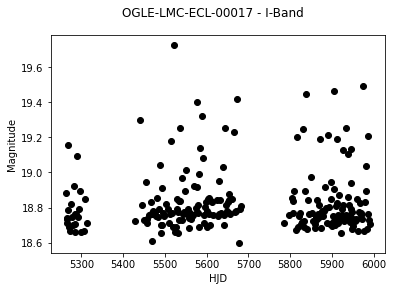

In [ ]:
degradedPlot(ecl[1], index)

In [ ]:
lomb = LombScargle(ecl[1]["HJD"], ecl[1]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl[1]['HJD']) - np.min(ecl[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 2.0
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.69171 dias
período dominante: 3.29e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0027689 dias


### Degradação para 3 anos de observação

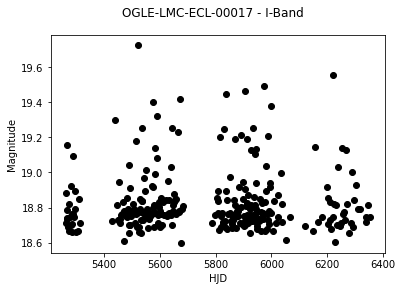

In [ ]:
degradedPlot(ecl[2], index)

In [ ]:
lomb = LombScargle(ecl[2]["HJD"], ecl[2]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl[2]['HJD']) - np.min(ecl[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 3.0
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6934 dias
período dominante: 3.29e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0044585 dias


### Degradação para 4 anos de observação

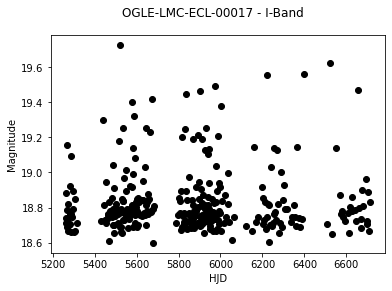

In [ ]:
degradedPlot(ecl[3], index)

In [ ]:
lomb = LombScargle(ecl[3]["HJD"], ecl[3]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl[3]['HJD']) - np.min(ecl[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 4.0
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.68304 dias
período dominante: 3.28e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0058955 dias


### Degradação para 4 anos e mais de observação

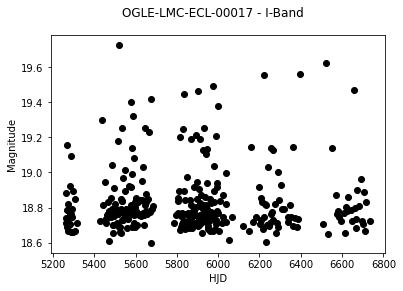

In [ ]:
degradedPlot(ecl[4], index)

In [ ]:
lomb = LombScargle(ecl[4]["HJD"], ecl[4]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl[4]['HJD']) - np.min(ecl[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 4.0
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.68397 dias
período dominante: 3.28e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0049671 dias


## Separação dos anos observados de acordo com os dados

In [ ]:
# separando em anos de observação
ecl_dados = []

ecl_dados.append(eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + 100])
ecl_dados.append(eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + 500])
ecl_dados.append(eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + 900])
ecl_dados.append(eclipsantes[index].loc[eclipsantes[index]['HJD'] < np.min(eclipsantes[index]['HJD']) + 1200])
ecl_dados.append(eclipsantes[index])

np.max(ecl_dados[0]['HJD']), np.max(ecl_dados[1]['HJD']),np.max(ecl_dados[2]['HJD']), np.max(ecl_dados[3]['HJD']), np.max(ecl_dados[4]['HJD'])

(5314.47436, 5682.47002, 6157.90533, 6397.4767, 6735.5862)

### Degraded

#### Primeiro período de observação

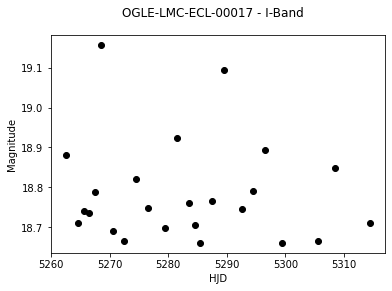

In [ ]:
degradedPlot(ecl_dados[0], index)

#### Segundo período de observação

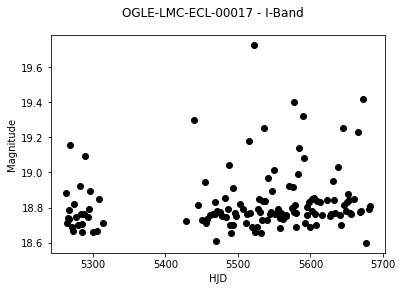

In [ ]:
degradedPlot(ecl_dados[1], index)

#### Terceiro período de observação

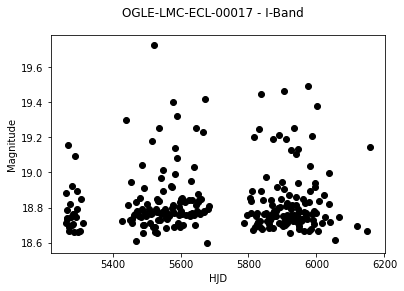

In [ ]:
degradedPlot(ecl_dados[2], index)

#### Quarto período de observação

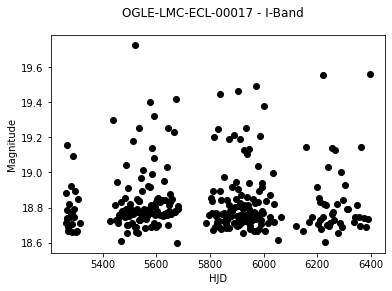

In [ ]:
degradedPlot(ecl_dados[3], index)

#### Quinto período de observação

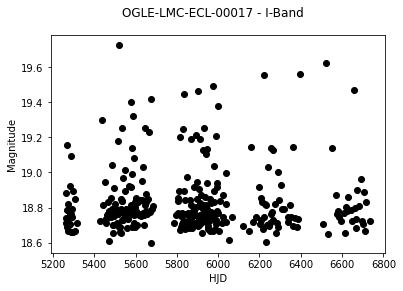

In [ ]:
degradedPlot(ecl_dados[4], index)

### Periodogram

#### Primeiro período de observação

In [ ]:
lomb = LombScargle(ecl_dados[0]["HJD"], ecl_dados[0]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl_dados[0]['HJD']) - np.min(ecl_dados[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 0.1
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 1.746819 dias
período dominante: 41.9 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 11.942 dias


#### Segundo período de observação

In [ ]:
lomb = LombScargle(ecl_dados[1]["HJD"], ecl_dados[1]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl_dados[1]['HJD']) - np.min(ecl_dados[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 1.2
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.70191 dias
período dominante: 3.29e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.012969 dias


#### Terceiro período de observação

In [ ]:
lomb = LombScargle(ecl_dados[2]["HJD"], ecl_dados[2]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl_dados[2]['HJD']) - np.min(ecl_dados[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 2.5
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.68065 dias
período dominante: 3.28e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0082858 dias


#### Quarto período de observação

In [ ]:
lomb = LombScargle(ecl_dados[3]["HJD"], ecl_dados[3]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl_dados[3]['HJD']) - np.min(ecl_dados[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 3.1
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.68258 dias
período dominante: 3.28e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0063579 dias


#### Quinto período de observação

In [ ]:
lomb = LombScargle(ecl_dados[4]["HJD"], ecl_dados[4]["mag"])
frequency, power = lomb.autopower(maximum_frequency= 25)
periodograma(index, frequency, power)

In [ ]:
dominant_freq = frequency[np.argmax(power)]

if query.loc[index][0].split('-')[2] == 'ECL':
  n=2
else:
  n=1
period = n/dominant_freq

print(f'''Observações em anos: {((np.max(ecl_dados[4]['HJD']) - np.min(ecl_dados[0]['HJD']))/365).round(1)}\n{'-'*30}
DADOS GERADOS\n{'-'*30}
      {query.loc[index][0]}\nperíodo dominante: {period:.7} dias
período dominante: {period*24:.3} horas\n
DADOS EXTRAÍDOS DO OGLE\n{'-'*30}
      {query.loc[index][0]}
período dominante: {query.loc[index][7]} dias
período dominante: {query.loc[index][7]*24:.3} horas
\n ERRO\n{'-'*30}
erro do período: {abs(query.loc[index][7]-(period)):.5} dias''')

Observações em anos: 4.0
------------------------------
DADOS GERADOS
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.68397 dias
período dominante: 3.28e+02 horas

DADOS EXTRAÍDOS DO OGLE
------------------------------
      OGLE-LMC-ECL-00017
período dominante: 13.6889402 dias
período dominante: 3.29e+02 horas

 ERRO
------------------------------
erro do período: 0.0049671 dias
